In [32]:
import pandas as pd
import sys

sys.path.append('../gtm/')
from corpus import GTMCorpus
from gtm_customized import GTM
import pickle as p

import os

language = 'en-zh'

In [33]:
def load_examples(language='en'):
  df = pd.read_csv('../data/wiki_shorts/{}/corpus/docs.txt'.format(language), header=None, delimiter='\t')
  df.columns = ['doc_clean']
  # df = df.head(1000)
  return df

In [34]:
if not os.path.exists('train_dataset_intfloat-e5-large2-{}.pkl'.format(language)):
  # if True:
  df_en = load_examples('en')
  df_zh = load_examples('zh')

  # merge two dfs into one df, with additional column specifying the language
  df_en['language'] = 'en'
  df_zh['language'] = 'zh'

  # randomly select 100 documents from each language
  # df_en = df_en.sample(n=100)
  # df_zh = df_zh.sample(n=100)

  # Concatenate the two DataFrames
  df = pd.concat([df_en, df_zh], ignore_index=True)

  train_dataset = GTMCorpus(
    df,
    count_words=True,
    embeddings_type='SentenceTransformer',
    sbert_model_to_load='intfloat/multilingual-e5-large',
    content=None,
    batch_size=64,
    max_seq_length=512)
  print('Saving train_dataset_intfloat-e5-large2-{}.pkl'.format(language))
  with open('train_dataset_intfloat-e5-large2-{}.pkl'.format(language), 'wb') as f:
    p.dump(train_dataset, f)
else:
  print('Loading train_dataset_intfloat-e5-large2-{}.pkl'.format(language))
  with open('train_dataset_intfloat-e5-large2-{}.pkl'.format(language), 'rb') as f:
    train_dataset = p.load(f)

print('dataset loaded')

Loading train_dataset_intfloat-e5-large2-en-zh.pkl
dataset loaded


In [35]:
# Train the model
tm = GTM(
	train_dataset,
	n_topics=6,
	doc_topic_prior='dirichlet', # logistic_normal, dirichlet
	alpha=0.02,
	update_prior=False,
	encoder_input='embeddings', # 'bow', 'embeddings'
  separate_encoders=True,
  separate_decoders=True,
	encoder_hidden_layers=[512, 256], # structure of the encoder neural net
	decoder_hidden_layers=[256], # structure of the decoder neural net
	encoder_bias=True,
	decoder_bias=True,
	num_epochs=0,
	print_every=10000,
	dropout=0.0,
	learning_rate=0.01,
	log_every=1,
	w_prior=None,
	batch_size=512,
	patience=5,
	save_path='../ckpt2/task4_2',
	ckpt='../ckpt2/task4_2/best_model.ckpt',
)

Loading checkpoint from ../ckpt2/task4_2/best_model.ckpt
OrderedDict([('encoder.enc_0.weight', tensor([[-0.0438,  0.0274,  0.0197,  ...,  0.0434,  0.0583, -0.0225],
        [-0.0678,  0.0608,  0.0885,  ...,  0.0592,  0.0705, -0.0774],
        [-0.0473,  0.0381,  0.0611,  ...,  0.0672,  0.0541, -0.0546],
        ...,
        [-0.0675,  0.0871,  0.0305,  ...,  0.0547,  0.0446, -0.0516],
        [-0.0409,  0.1016,  0.0499,  ...,  0.0860,  0.0526, -0.0800],
        [-0.0653,  0.0682,  0.0679,  ...,  0.0749,  0.0890, -0.0676]],
       device='mps:0')), ('encoder.enc_0.bias', tensor([-3.9459e-02, -6.2512e-02, -3.5683e-02, -6.7079e-02, -3.9315e-02,
        -6.3501e-02, -1.2522e-02,  3.6070e-02, -4.3646e-02, -2.2668e-02,
        -3.1477e-02, -4.9394e-02, -9.7406e-02, -8.4202e-02, -5.4723e-02,
        -5.5466e-02, -3.1226e-02, -6.0139e-02, -4.6450e-02, -5.4946e-02,
        -5.4899e-02, -2.0152e-02, -3.7330e-02, -2.6702e-02, -6.1973e-02,
        -3.7209e-02,  3.7727e-02, -1.7631e-02, -6.6910e-02

In [36]:
import numpy as np

def inspect(tm, ds):
  doc_topic_distribution = tm.get_doc_topic_distribution(ds)

  print('Number of documents per topic')
  print('Topic 0: {}'.format((doc_topic_distribution.argmax(-1) == 0).sum()))
  print('Topic 1: {}'.format((doc_topic_distribution.argmax(-1) == 1).sum()))
  print('Topic 2: {}'.format((doc_topic_distribution.argmax(-1) == 2).sum()))
  print('Topic 3: {}'.format((doc_topic_distribution.argmax(-1) == 3).sum()))
  print('Topic 4: {}'.format((doc_topic_distribution.argmax(-1) == 4).sum()))
  print('Topic 5: {}'.format((doc_topic_distribution.argmax(-1) == 5).sum()))

  # show five random documents per topic
  for topic in range(tm.n_topics):
    print('Topic {}'.format(topic))
    print('xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx')
    for i in np.random.choice(np.where(doc_topic_distribution.argmax(-1) == topic)[0], 5):
      print('=' * 50)
      print(ds.df.iloc[i]['doc_clean'])
      print('----------')
      print('Topic distribution = {}'.format(doc_topic_distribution[i]))

In [37]:
inspect(tm, train_dataset)

Number of documents per topic
Topic 0: 2678
Topic 1: 2070
Topic 2: 1859
Topic 3: 10135
Topic 4: 2682
Topic 5: 1754
Topic 0
xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
the faroese goose froyska gsin faroese probably the oldest form tame goose europe and possibly the direct descendant the tame goose that the landnm folk bring from scandinavia and the british isle since the faroe island have predator that can kill the goose special goose culture have develop the faroe island which have equivalent neighbor country from may october one can see flock geese walk freely the outfield where they fee the short summer grass without any supplementary feeding winter the geese move freely the cultivated infield the village which some case such good quality that earlier the goose not need complementary feed the winter most place however caretaker provide supplementary food just before and during egg laying and when snow the ground the property today faroese geese result from natur

In [38]:
# write a function to write all examples of the same topic to a file
def write_topic_to_file(topic_id, ds, doc_topic_distribution, path):
  with open(path, 'w') as f:
    for i in np.where(doc_topic_distribution.argmax(-1) == topic_id)[0]:
      f.write(ds.df.iloc[i]['doc_clean'] + '\n')

In [39]:
doc_topic_distribution = tm.get_doc_topic_distribution(train_dataset)
import os

if not os.path.exists('../data/task4_2'):
  os.makedirs('../data/task4_2')

In [40]:
write_topic_to_file(0, train_dataset, doc_topic_distribution, '../data/task4_2/topic_0.txt')
write_topic_to_file(1, train_dataset, doc_topic_distribution, '../data/task4_2/topic_1.txt')
write_topic_to_file(2, train_dataset, doc_topic_distribution, '../data/task4_2/topic_2.txt')
write_topic_to_file(3, train_dataset, doc_topic_distribution, '../data/task4_2/topic_3.txt')
write_topic_to_file(4, train_dataset, doc_topic_distribution, '../data/task4_2/topic_4.txt')
write_topic_to_file(5, train_dataset, doc_topic_distribution, '../data/task4_2/topic_5.txt')

In [41]:
# read labels
def read_labels(language='en'):
  with open('../data/wiki_shorts/{}/corpus/docs.txt'.format(language), 'r') as file:
    docs = file.readlines()
  with open('../data/wiki_shorts/{}/labels.txt'.format(language), 'r') as file:
    labels = file.readlines()

  # one to one mapping of docs to labels
  doc2label = {}
  for i in range(len(docs)):
    doc2label[docs[i][:100].strip()] = int(labels[i].strip())
  return doc2label

In [42]:
doc2label_en = read_labels('en')
doc2label_zh = read_labels('zh')

In [43]:
# for each topic, find its majority label
from collections import defaultdict

def find_majority_label(topic):
  label2cnt = defaultdict(int)
  labels = []
  with open('../data/task4_2/topic_{}.txt'.format(topic), 'r') as file:
    lines = file.readlines()
    for line in lines:
      k = line[:100].strip()
      if k in doc2label_en:
        v = doc2label_en[k]
      else:
        v = doc2label_zh[k]
      label2cnt[v] += 1
      labels.append(v)
  predicted = max(label2cnt, key=lambda k: label2cnt[k])
  return label2cnt, labels, predicted

In [44]:
_, labels_0, predicted_0 = find_majority_label(0)
_, labels_1, predicted_1 = find_majority_label(1)
_, labels_2, predicted_2 = find_majority_label(2)
_, labels_3, predicted_3 = find_majority_label(3)
_, labels_4, predicted_4 = find_majority_label(4)
_, labels_5, predicted_5 = find_majority_label(5)

In [45]:
print(predicted_0, predicted_1, predicted_2, predicted_3, predicted_4, predicted_5)

2 0 4 0 1 0


In [46]:
final_labels = labels_0 + labels_1 + labels_2 + labels_3 + labels_4 + labels_5

In [47]:
len(final_labels)

21178

In [48]:
final_pred = [predicted_0] * len(labels_0) + [predicted_1] * len(labels_1) + [predicted_2] * len(labels_2) + [
  predicted_3] * len(labels_3) + [predicted_4] * len(labels_4) + [predicted_5] * len(labels_5)

In [49]:
len(final_pred)

21178

In [50]:
model_pred = [0]*len(labels_0) + [1]*len(labels_1) + [2]*len(labels_2) + [3]*len(labels_3) + [4]*len(labels_4) + [5]*len(labels_5)

In [51]:
from sklearn.metrics import f1_score, accuracy_score, adjusted_rand_score

f1_macro = f1_score(y_true=final_labels, y_pred=final_pred, average='macro')
f1_micro = f1_score(y_true=final_labels, y_pred=final_pred, average='micro')
acc = accuracy_score(y_true=final_labels, y_pred=final_pred)
ars = adjusted_rand_score(labels_true=final_labels, labels_pred=model_pred)

In [52]:
print('f1_macro = {}'.format(f1_macro))
print('f1_micro = {}'.format(f1_micro))
print('acc = {}'.format(acc))
print('ars = {}'.format(ars))

f1_macro = 0.29329151064312464
f1_micro = 0.36311266408537163
acc = 0.36311266408537163
ars = 0.07942958594843537


In [53]:
wordcloud_args = {'background_color': 'white',
                  'font_path': '/System/Library/Fonts/Supplemental/Songti.ttc',
                  'min_font_size': 10,
                  'max_font_size': 100,
                  'max_words': 2000,
                  'height': 1000,
                  'width': 2000}

{'台湾': 0.1190030500292778, '大学': 0.07968469709157944, '中国': 0.07367759943008423, '电影': 0.04318138584494591, '美国': 0.02918192371726036, '音乐': 0.017658473923802376, '香港': 0.014441044069826603, '成为': 0.014248266816139221, '自己': 0.012321701273322105, '专辑': 0.009656456299126148, '日本': 0.00953785888850689, '第一': 0.009093523025512695, '他们': 0.008882084861397743, '担任': 0.008445450104773045, '开始': 0.008172047324478626, '年月': 0.007891260087490082, '学院': 0.007838781923055649, '以及': 0.007709179539233446, '世界': 0.005986531265079975, '英语': 0.005908840801566839, '运动': 0.005401370115578175, '中华': 0.004519532434642315, '乐团': 0.004310376476496458, '国家': 0.004197220783680677, '主义': 0.004152724985033274, '作品': 0.00409950315952301, '历史': 0.0038700844161212444, '发行': 0.0038668946363031864, '民国': 0.003816047916188836, '政府': 0.0033333427272737026, '认为': 0.0032701422460377216, '上映': 0.003168310970067978, '公司': 0.0030482939910143614, '学校': 0.002989100757986307, '制作': 0.002946734195575118, '北京': 0.00289093959145

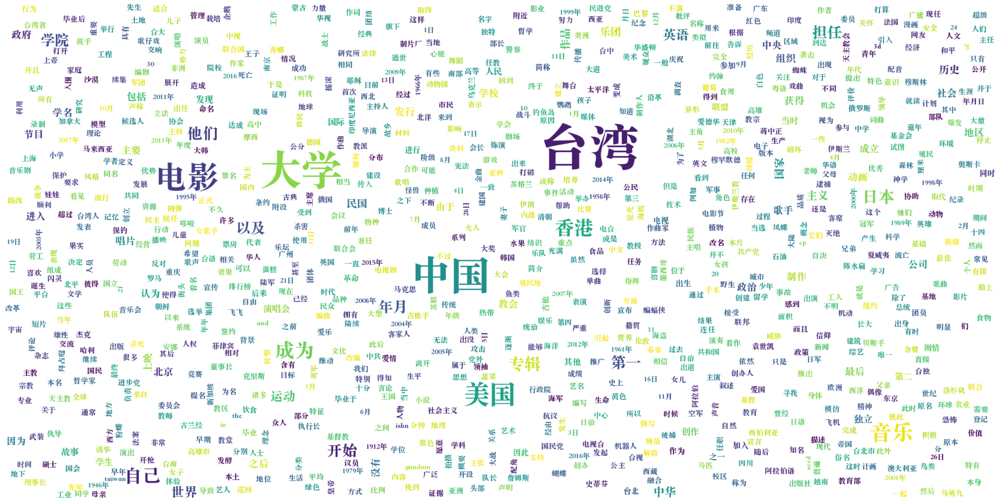

In [54]:
tm.plot_wordcloud(topic_id=0, topK=1000, output_path='../data/task4_2/topic_0.jpg', wordcloud_args=wordcloud_args, figsize=(40, 80))

{'台湾': 0.01197452750056982, '中国': 0.007113778032362461, '大学': 0.0066723451018333435, '电影': 0.005625481251627207, '美国': 0.004395844414830208, '香港': 0.003786824643611908, '音乐': 0.0035565311554819345, '成为': 0.003017679089680314, '自己': 0.0027275593020021915, '专辑': 0.0019861734472215176, '担任': 0.001931670936755836, '开始': 0.0019172739703208208, '第一': 0.0018902873853221536, '日本': 0.001817421754822135, '学院': 0.0016365052433684468, '他们': 0.001621813396923244, '年月': 0.0016105902614071965, '发行': 0.0016103615052998066, '以及': 0.0015610523987561464, '英语': 0.0014220589073374867, '世界': 0.0013745591277256608, '乐团': 0.0013193589402362704, '历史': 0.0012790965847671032, '公司': 0.0011280550388619304, '上映': 0.0010916544124484062, '作品': 0.0010753213427960873, '中华': 0.0010707746259868145, '动画': 0.0010610056342557073, '政治': 0.0010606094729155302, '演唱会': 0.001028441358357668, '国家': 0.001022854121401906, '没有': 0.001017827889882028, '获得': 0.0009733781334944069, '节目': 0.0009673140593804419, '制作': 0.00095736270304769

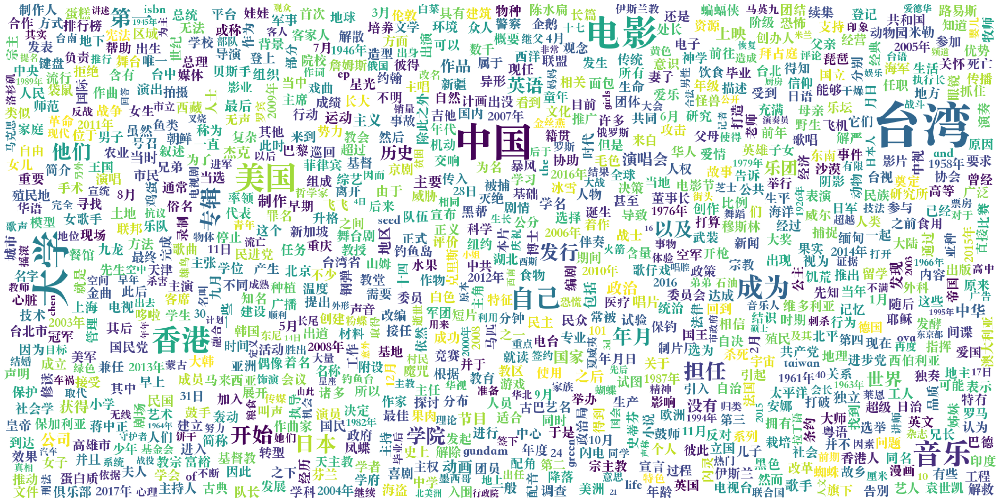

In [55]:
tm.plot_wordcloud(topic_id=1, topK=1000, output_path='../data/task4_2/topic_1.jpg', wordcloud_args=wordcloud_args, figsize=(40, 80))

{'大学': 0.058184634894132614, '台湾': 0.05086393281817436, '中国': 0.031910624355077744, '电影': 0.0282624289393425, '美国': 0.021649664267897606, '音乐': 0.013809849508106709, '香港': 0.012014785781502724, '成为': 0.010899368673563004, '自己': 0.00955704040825367, '学院': 0.008154480718076229, '专辑': 0.007974999956786633, '日本': 0.0077791535295546055, '第一': 0.0073243919759988785, '开始': 0.00701617356389761, '担任': 0.006979358848184347, '他们': 0.006254935637116432, '年月': 0.006242475006729364, '世界': 0.005751484539359808, '以及': 0.005532224662601948, '国家': 0.004496665205806494, '民国': 0.004171989858150482, '英语': 0.0037375204265117645, '乐团': 0.003656094428151846, '中华': 0.003613439155742526, '北京': 0.0034978692419826984, '上映': 0.0033829861786216497, '作品': 0.003306119702756405, '制作': 0.0031419084407389164, '历史': 0.0029250564984977245, '主义': 0.0027857900131493807, '之后': 0.0027421258855611086, '运动': 0.002742038108408451, '认为': 0.00266812345944345, '成立': 0.002515888772904873, '学校': 0.0025036807637661695, '政治': 0.0024315

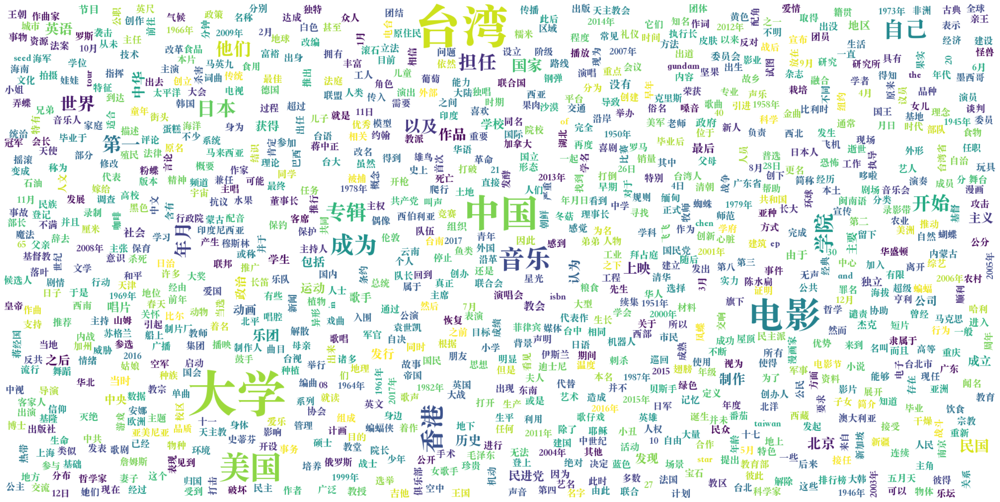

In [56]:
tm.plot_wordcloud(topic_id=2, topK=1000, output_path='../data/task4_2/topic_2.jpg', wordcloud_args=wordcloud_args, figsize=(40, 80))

{'台湾': 0.007185544352978468, '中国': 0.004575655795633793, '美国': 0.0034979304764419794, '电影': 0.003428451018407941, '大学': 0.003375291358679533, '音乐': 0.0026277611032128334, '他们': 0.00210315128788352, '英语': 0.0020141275599598885, '第一': 0.0019879417959600687, '自己': 0.0019346812041476369, '开始': 0.0018694123718887568, '成为': 0.0018458570120856166, '专辑': 0.001811591675505042, '年月': 0.0016143722459673882, '香港': 0.0015242574736475945, '日本': 0.0015210033161565661, '担任': 0.001500496524386108, '乐团': 0.0014714706921949983, '因为': 0.0014610699145123363, '发行': 0.0014600892318412662, '国家': 0.0014345863601192832, '政府': 0.0014141477877274156, '主义': 0.0014110184274613857, '学校': 0.0013887154636904597, '主要': 0.0013753660023212433, '运动': 0.0013670269399881363, '历史': 0.0012999697355553508, '地区': 0.0012869136407971382, '获得': 0.0012862634612247348, '政治': 0.0012811271008104086, '之后': 0.0012640225468203425, '组织': 0.0012590604601427913, '成立': 0.0012541422620415688, '独立': 0.001247553969733417, '公司': 0.00124619284179

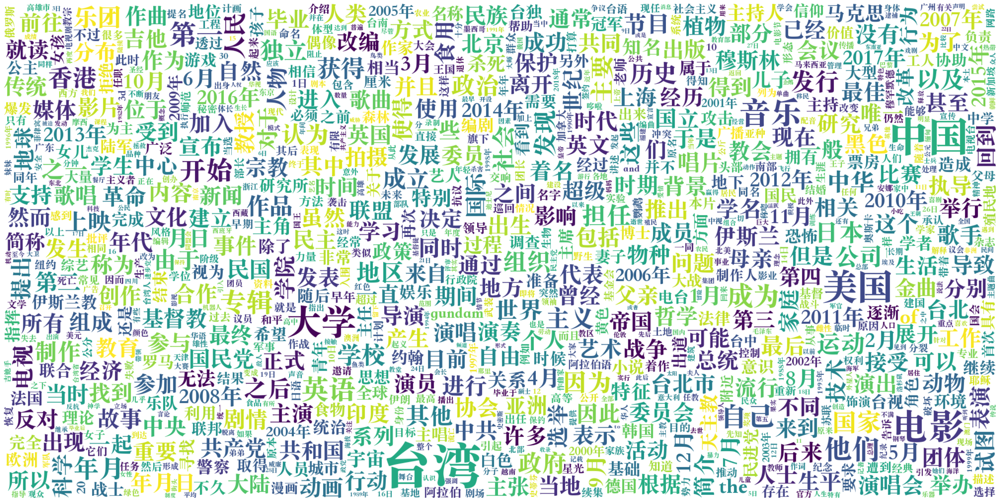

In [57]:
tm.plot_wordcloud(topic_id=3, topK=1000, output_path='../data/task4_2/topic_3.jpg', wordcloud_args=wordcloud_args, figsize=(40, 80))

{'台湾': 0.019570263102650642, '中国': 0.011200737208127975, '大学': 0.009810199961066246, '电影': 0.00913229025900364, '美国': 0.006575233303010464, '他们': 0.005326804704964161, '自己': 0.005107077769935131, '香港': 0.004991487134248018, '音乐': 0.004401973448693752, '第一': 0.003554369555786252, '成为': 0.0035263036843389273, '担任': 0.0031422381289303303, '开始': 0.002582545392215252, '英语': 0.002525933552533388, '日本': 0.0025032772682607174, '专辑': 0.0024669647682458162, '乐团': 0.0023942189291119576, '年月': 0.0023688983637839556, '以及': 0.0021246790420264006, '世界': 0.001984859351068735, '制作': 0.0019828546792268753, '主义': 0.0019799002911895514, '中华': 0.001916813082061708, '学院': 0.0018053874373435974, '节目': 0.0017091742483898997, '动画': 0.0016624554991722107, '最后': 0.0016329888021573424, '国家': 0.00162802217528224, '发行': 0.001621740055270493, '政府': 0.0016044076764956117, '北京': 0.0015933095710352063, '上映': 0.0015883409650996327, '运动': 0.0015571332769468427, '历史': 0.0015478802379220724, '由于': 0.0014398862840607762, '政

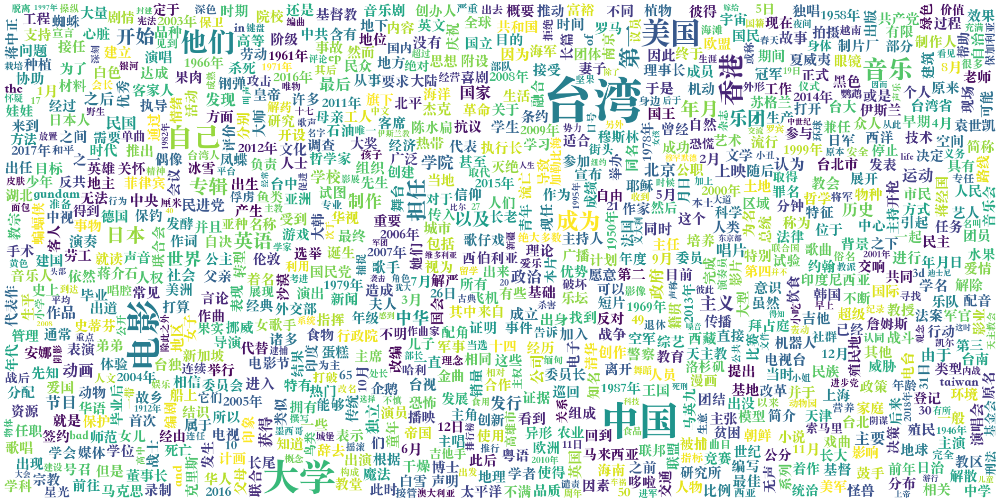

In [58]:
tm.plot_wordcloud(topic_id=4, topK=1000, output_path='../data/task4_2/topic_4.jpg', wordcloud_args=wordcloud_args, figsize=(40, 80))

{'圣堂': 0.001408439944498241, '供养': 0.0014062393456697464, '勐虎': 0.0008526003803126514, '锄头': 0.0008079755934886634, '塞入': 0.0007126705604605377, '王敏川': 0.0007076402544043958, '两千万': 0.0006797577952966094, '声请': 0.0006743205594830215, '封死': 0.0006617414182983339, '境遇': 0.0006538572488352656, '虎弟': 0.0006518123554997146, '当空': 0.0006286273128353059, '粉末': 0.0006270639132708311, '九龙': 0.0006167799001559615, '劲歌': 0.0006042227614670992, '罕有': 0.0006028172210790217, '世宗': 0.0006008408381603658, '木棉花': 0.0005859632510691881, 'sense': 0.0005794564494863153, '阿萨姆邦': 0.0005517767858691514, '禁区': 0.0005494985380209982, '如潮': 0.0005354885943233967, '早饭': 0.0005107931210659444, '摆满': 0.000506691518239677, '淀粉质': 0.0004928102716803551, '鲍勃': 0.0004699690907727927, '妮可': 0.00046759453834965825, '成长于': 0.0004581264511216432, '团员们': 0.0004573286569211632, '园方': 0.00045340138603933156, '家暴': 0.0004515133623499423, '总榜': 0.0004421460907906294, '住了': 0.0004344785993453115, '届龄': 0.0004295695398468524, 's

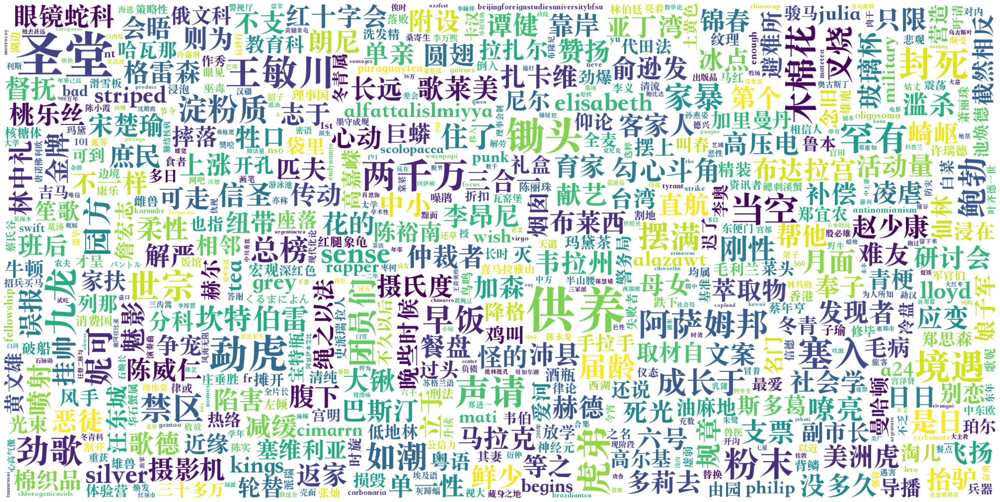

In [59]:
tm.plot_wordcloud(topic_id=5, topK=1000, output_path='../data/task4_2/topic_5.jpg', wordcloud_args=wordcloud_args, figsize=(40, 80))